# 🚖📊 Comprehensive Taxi & Air Pollution Analysis Notebook
This notebook guides you through an end-to-end analysis of taxi mobility and air quality data in Chicago, including:
1. Detailed data exploration (EDA)
2. Spatio-temporal joining via GeoHash and hourly bins
3. Pattern and correlation analysis
4. Clustering with DBSCAN and silhouette evaluation
5. Parameter sweeps to tune DBSCAN
6. A weighted-DBSCAN variant
7. Visual summaries and key findings

## 1. Setup & Data Loading

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geohash
from datetime import timedelta
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
plt.rcParams['figure.figsize'] = (10,4)
%matplotlib inline

In [3]:
# Load datasets
taxi_df = pd.read_csv('taxi_data.csv', parse_dates=['timestamp'])
aq_df = pd.read_csv('air_quality_data.csv', parse_dates=['timestamp'])
print('Taxi shape:', taxi_df.shape)
print('AQ shape:', aq_df.shape)

Taxi shape: (1999995, 4)
AQ shape: (892800, 5)


## 2. Exploratory Data Analysis (EDA)
### 2.1 Taxi Data Exploration

In [4]:
taxi_df.head()

,trip_id,timestamp,latitude,longitude
0,0,2021-01-19 20:00:47.523788,41.774400,-87.751039
1,1,2021-01-06 06:52:11.642360,41.777312,-87.744953
2,2,2021-01-03 00:23:54.121600,41.771980,-87.748132
3,3,2021-01-30 09:58:14.074094,41.776002,-87.742006
4,4,2021-01-30 22:25:47.871755,41.775025,-87.752370


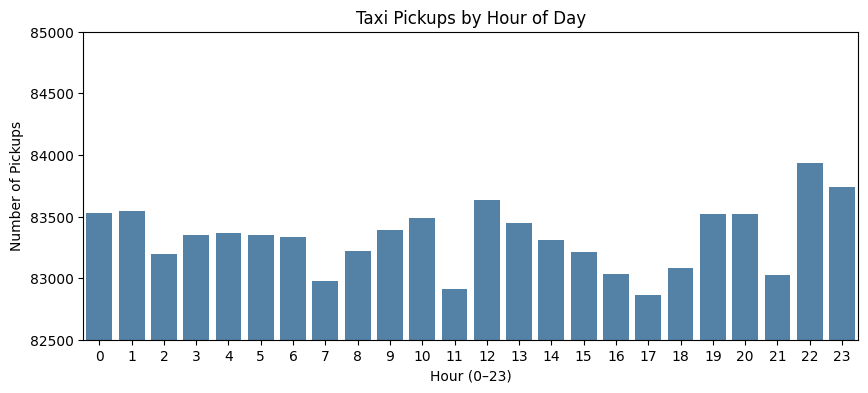

In [13]:
# Taxi pickups by hour
taxi_df['hour'] = taxi_df['timestamp'].dt.hour
plt.figure(figsize=(10,4))
sns.countplot(x='hour', data=taxi_df, color='steelblue')
plt.title('Taxi Pickups by Hour of Day')
plt.xlabel('Hour (0–23)')
plt.ylabel('Number of Pickups')
plt.ylim(82500, 85000)  # Set Y-axis limits
plt.show()

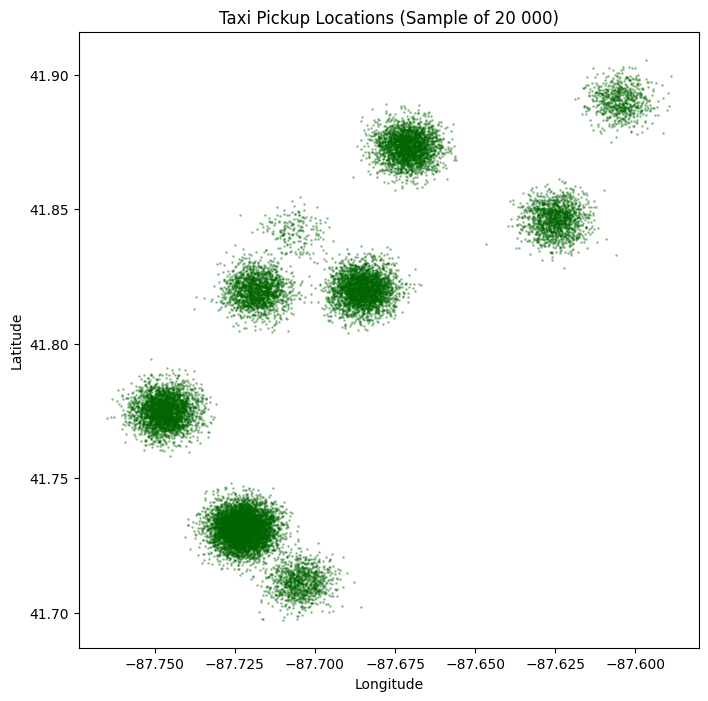

In [14]:
# Spatial scatter of taxi pickups (sample)
sample = taxi_df.sample(20000)
plt.figure(figsize=(8,8))
plt.scatter(
    sample['longitude'],
    sample['latitude'],
    s=1,
    alpha=0.3,
    color='darkgreen'
)
plt.title('Taxi Pickup Locations (Sample of 20 000)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


### 2.2 Air Quality Data Exploration

In [10]:
aq_df.head()

,device_id,timestamp,latitude,longitude,pm25
0,S0_0,2021-01-01 00:00:00,41.777061,-87.746768,25.851584
1,S0_0,2021-01-01 00:10:00,41.777061,-87.746768,23.783739
2,S0_0,2021-01-01 00:20:00,41.777061,-87.746768,23.291163
3,S0_0,2021-01-01 00:30:00,41.777061,-87.746768,23.817897
4,S0_0,2021-01-01 00:40:00,41.777061,-87.746768,25.220790


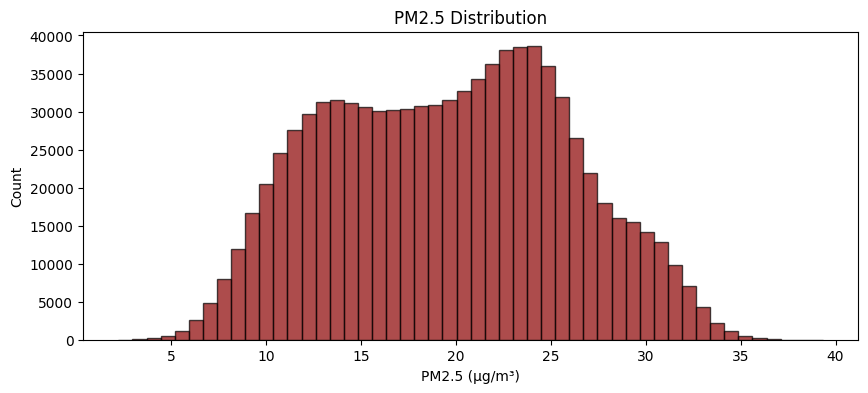

In [17]:
# 1) PM2.5 distribution with Matplotlib
plt.figure(figsize=(10,4))
plt.hist(aq_df['pm25'].values, bins=50, color='darkred', edgecolor='black', alpha=0.7)
plt.title('PM2.5 Distribution')
plt.xlabel('PM2.5 (µg/m³)')
plt.ylabel('Count')
plt.show()


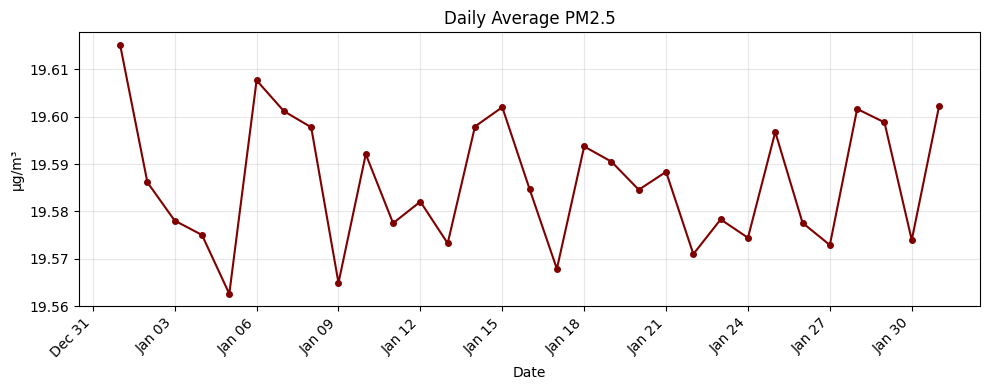

In [20]:
import matplotlib.dates as mdates

# Recompute daily_pm if needed
daily_pm = aq_df.set_index('timestamp')['pm25'].resample('D').mean()

fig, ax = plt.subplots(figsize=(10,4))

# Convert index to Python datetime array
dates = daily_pm.index.to_pydatetime()
values = daily_pm.values

# Plot
ax.plot(dates, values, color='maroon', marker='o', ms=4)
ax.set_title('Daily Average PM2.5')
ax.set_xlabel('Date')
ax.set_ylabel('µg/m³')
ax.grid(alpha=0.3)

# Date formatting
ax.xaxis.set_major_locator(mdates.DayLocator(interval=3))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
fig.autofmt_xdate(rotation=45, ha='right')

plt.tight_layout()
plt.show()


## 3. Spatio-Temporal Join via GeoHash

In [ ]:
# 3.1 Compute GeoHash + hourly floor
PREC = 6
for df, name in [(taxi_df, 'Taxi'), (aq_df, 'Air Quality')]:
    df['geohash'] = df.apply(lambda r: geohash.encode(r.latitude, r.longitude, PREC), axis=1)
    df['hour']    = df['timestamp'].dt.floor('h')
    print(f"\n{name} data with new columns:")
    display(df[['timestamp','latitude','longitude','geohash','hour']].head())



Taxi data with new columns:


,timestamp,latitude,longitude,geohash,hour
0,2021-01-19 20:00:47.523788,41.774400,-87.751039,dp3teh,2021-01-19 20:00:00
1,2021-01-06 06:52:11.642360,41.777312,-87.744953,dp3tem,2021-01-06 06:00:00
2,2021-01-03 00:23:54.121600,41.771980,-87.748132,dp3teh,2021-01-03 00:00:00
3,2021-01-30 09:58:14.074094,41.776002,-87.742006,dp3tem,2021-01-30 09:00:00
4,2021-01-30 22:25:47.871755,41.775025,-87.752370,dp3teh,2021-01-30 22:00:00



Air Quality data with new columns:


,timestamp,latitude,longitude,geohash,hour
0,2021-01-01 00:00:00,41.777061,-87.746768,dp3tem,2021-01-01
1,2021-01-01 00:10:00,41.777061,-87.746768,dp3tem,2021-01-01
2,2021-01-01 00:20:00,41.777061,-87.746768,dp3tem,2021-01-01
3,2021-01-01 00:30:00,41.777061,-87.746768,dp3tem,2021-01-01
4,2021-01-01 00:40:00,41.777061,-87.746768,dp3tem,2021-01-01


### 3.1 Aggregate by (geohash, hour)

In [24]:
# 3.2 Aggregate & join on (geohash, hour)
# — re‐floor with lowercase 'h' to silence the warning
taxi_df['hour'] = taxi_df['timestamp'].dt.floor('h')
aq_df['hour']   = aq_df['timestamp'].dt.floor('h')

# — Taxi: count pickups per cell‐hour
taxi_agg = (
    taxi_df
    .groupby(['geohash','hour'])
    .size()
    .rename('pickup_count')
    .reset_index()
)

# — Air quality: average PM2.5 per cell‐hour
aq_agg = (
    aq_df
    .groupby(['geohash','hour'])['pm25']
    .mean()
    .rename('mean_pm25')
    .reset_index()
)

# — Inner join: only times/cells where we have both
joined = pd.merge(taxi_agg, aq_agg, on=['geohash','hour'], how='inner')

# Preview the result
print("Joined shape:", joined.shape)
joined.head()


Joined shape: (23758, 4)


,geohash,hour,pickup_count,mean_pm25
0,dp3t7s,2021-01-01 00:00:00,85,29.674033
1,dp3t7s,2021-01-01 01:00:00,73,29.959144
2,dp3t7s,2021-01-01 02:00:00,82,31.696172
3,dp3t7s,2021-01-01 03:00:00,91,31.710573
4,dp3t7s,2021-01-01 04:00:00,74,30.447085


## 4. Pattern & Correlation Analysis

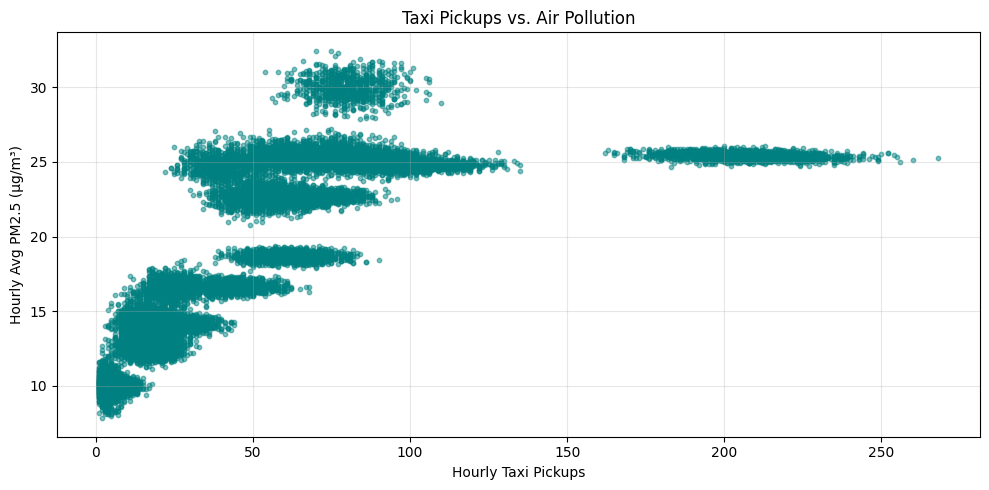

Pearson correlation (pickups vs PM2.5): 0.72


In [30]:
# 4.1 Scatter & Pearson correlation

plt.figure(figsize=(10,5))
plt.scatter(
    joined['pickup_count'], 
    joined['mean_pm25'], 
    alpha=0.5, 
    s=10, 
    color='teal'
)
plt.xlabel('Hourly Taxi Pickups')
plt.ylabel('Hourly Avg PM2.5 (µg/m³)')
plt.title('Taxi Pickups vs. Air Pollution')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

# Compute Pearson correlation
r = joined['pickup_count'].corr(joined['mean_pm25'])
print(f"Pearson correlation (pickups vs PM2.5): {r:.2f}")


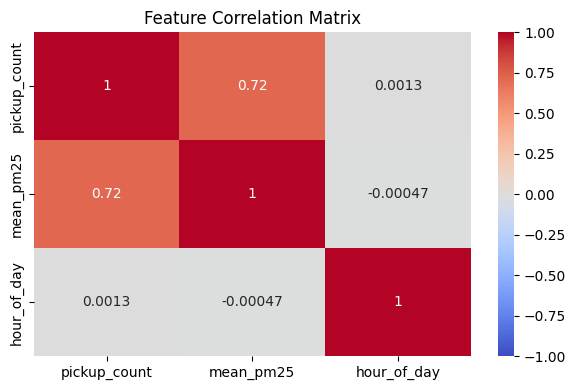

In [31]:
# 4.2 Correlation matrix heatmap (including time of day)
# add hour_of_day feature
joined['hour_of_day'] = joined['hour'].dt.hour

corr_mat = joined[['pickup_count','mean_pm25','hour_of_day']].corr()

plt.figure(figsize=(6,4))
sns.heatmap(
    corr_mat, 
    annot=True, 
    cmap='coolwarm', 
    vmin=-1, vmax=1
)
plt.title('Feature Correlation Matrix')
plt.tight_layout()
plt.show()


## 5. DBSCAN Clustering & Evaluation

In [35]:
# 5.1a) Compute centroids for each cell‐hour from taxi_df
centroids = (
    taxi_df
    .groupby(['geohash','hour'])[['latitude','longitude']]
    .mean()
    .reset_index()
)

In [36]:
# 5.1b) Merge those centroids into joined
joined_coords = pd.merge(
    joined,
    centroids,
    on=['geohash','hour'],
    how='left'
)

In [37]:
# 5.1c) Now prepare X with lat, lon, pm25, pickups, hour_of_day
X = np.vstack([
    joined_coords['latitude'],
    joined_coords['longitude'],
    joined_coords['mean_pm25'],
    joined_coords['pickup_count'],
    joined_coords['hour'].dt.hour
]).T

In [39]:
# 5.2 Scale
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
print("Feature matrix shape:", X_scaled.shape)

Feature matrix shape: (23758, 5)


In [40]:
# 5.3 DBSCAN
db = DBSCAN(eps=0.5, min_samples=10).fit(X_scaled)
joined_coords['cluster'] = db.labels_

In [41]:
# 5.4 Silhouette
mask = joined_coords['cluster'] != -1
score = silhouette_score(X_scaled[mask], joined_coords.loc[mask,'cluster'])
print(f"DBSCAN silhouette score: {score:.3f}")

DBSCAN silhouette score: 0.354


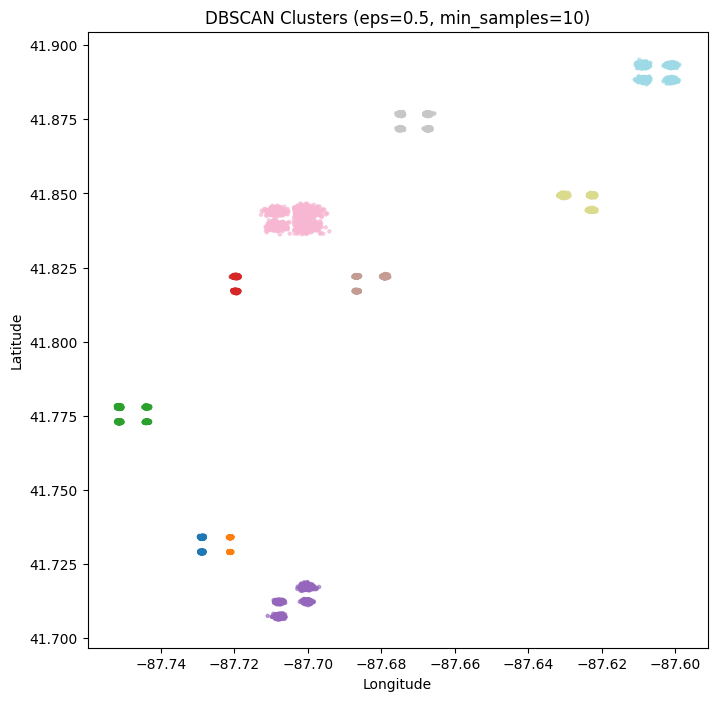

In [42]:
# 5.5 Plot a sample of clusters
sample = joined_coords.sample(20000, random_state=42)
plt.figure(figsize=(8,8))
plt.scatter(
    sample['longitude'],
    sample['latitude'],
    c=sample['cluster'],
    cmap='tab20',
    s=5,
    alpha=0.6
)
plt.title('DBSCAN Clusters (eps=0.5, min_samples=10)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

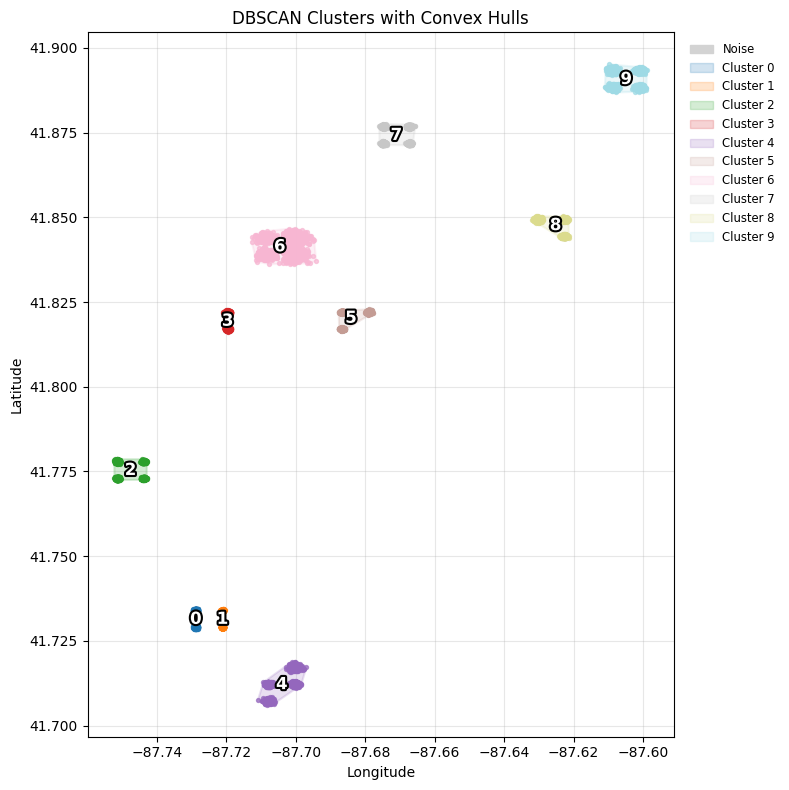

In [46]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from shapely.geometry import MultiPoint
import matplotlib.patheffects as pe

# Sample to speed up
sample = joined_coords.sample(20000, random_state=42)
noise  = sample[sample['cluster']==-1]
core   = sample[sample['cluster']!=-1]

# Cluster IDs and colors
cluster_ids = sorted(core['cluster'].unique())
n = len(cluster_ids)
cmap = plt.get_cmap('tab20', n)

# Compute hulls
hulls = {}
for idx, cl in enumerate(cluster_ids):
    pts = core[core['cluster']==cl][['longitude','latitude']].values
    hull = MultiPoint(pts).convex_hull
    hulls[cl] = hull

fig, ax = plt.subplots(figsize=(8,8))

# 1) Plot noise
ax.scatter(
    noise['longitude'], noise['latitude'],
    s=5, c='lightgrey', alpha=0.5, label='Noise', zorder=1
)

# 2) Plot each hull + points
for idx, cl in enumerate(cluster_ids):
    hull = hulls[cl]
    xh, yh = hull.exterior.xy
    ax.fill(xh, yh, 
            facecolor=cmap(idx), alpha=0.2, 
            edgecolor=cmap(idx), linewidth=1.5, zorder=2)
    pts = core[core['cluster']==cl]
    ax.scatter(
        pts['longitude'], pts['latitude'],
        s=8, color=cmap(idx), alpha=0.7, zorder=3
    )

# 3) Annotate centroids
centroids = joined_coords.groupby('cluster')[['longitude','latitude']].mean().loc[cluster_ids]
for idx, (cl, row) in enumerate(centroids.iterrows()):
    ax.text(
        row['longitude'], row['latitude'], str(int(cl)),
        ha='center', va='center', color='white', weight='bold',
        path_effects=[pe.withStroke(linewidth=3, foreground='black')],
        fontsize=12, zorder=4
    )

# 4) Legend & styling
handles = [mpatches.Patch(color=cmap(i), alpha=0.2, label=f'Cluster {cl}') 
           for i,cl in enumerate(cluster_ids)]
handles.insert(0, mpatches.Patch(color='lightgrey', label='Noise'))
ax.legend(handles, [h.get_label() for h in handles],
          loc='upper left', bbox_to_anchor=(1.01,1), frameon=False, fontsize='small')

ax.set_title('DBSCAN Clusters with Convex Hulls')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.grid(alpha=0.3)
plt.tight_layout()
plt.show()


## 6. Parameter Sweep & Silhouette Analysis

In [48]:
# Define grid
eps_vals = np.linspace(0.1, 1.0, 10)
min_samples_vals = [5, 10, 20, 50]

results = []
for eps in eps_vals:
    for ms in min_samples_vals:
        db = DBSCAN(eps=eps, min_samples=ms).fit(X_scaled)
        lbl = db.labels_
        mask = lbl != -1
        # require at least 2 clusters
        if mask.sum() and len(set(lbl[mask])) > 1:
            score = silhouette_score(X_scaled[mask], lbl[mask])
            results.append({'eps': eps, 'min_samples': ms, 'silhouette': score})

res_df = pd.DataFrame(results)

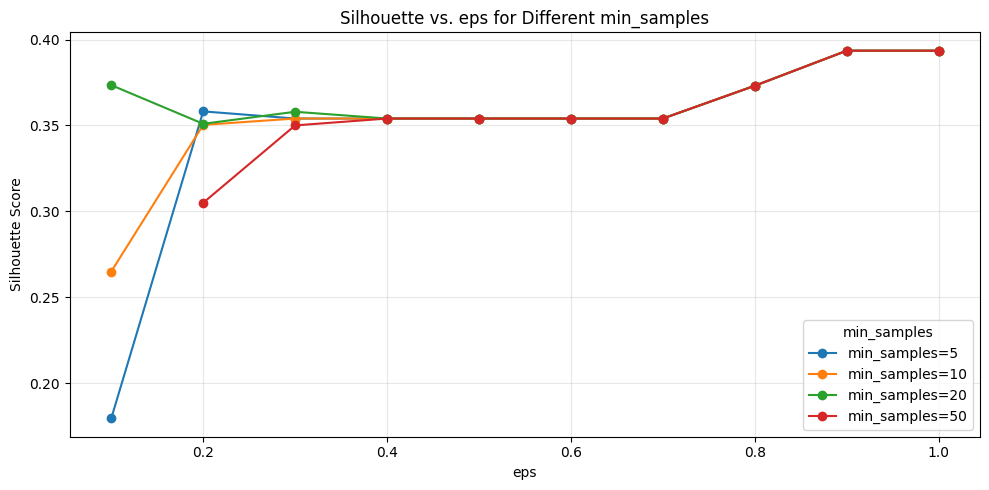

In [50]:
plt.figure(figsize=(10,5))

for ms in min_samples_vals:
    sub = res_df[res_df['min_samples'] == ms]
    x = sub['eps'].to_numpy()
    y = sub['silhouette'].to_numpy()
    plt.plot(x, y, marker='o', label=f'min_samples={ms}')

plt.xlabel('eps')
plt.ylabel('Silhouette Score')
plt.title('Silhouette vs. eps for Different min_samples')
plt.legend(title='min_samples')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


## 7. Weighted-DBSCAN Variant

In [51]:
# 7. Weighted‐DBSCAN Silhouette & Map

import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from shapely.geometry import MultiPoint
import matplotlib.patheffects as pe

# 7.1 Build weighted distance matrix
def weighted_dist(u, v, w_sp=0.7, w_ft=0.3):
    ds = np.linalg.norm(u[:2] - v[:2])      # spatial
    df = np.linalg.norm(u[2:] - v[2:])      # pm25, pickups, hour
    return w_sp*ds + w_ft*df

D = pairwise_distances(X_scaled, metric=lambda a, b: weighted_dist(a, b))

# 7.2 Fit DBSCAN with precomputed matrix
db_w = DBSCAN(eps=0.5, min_samples=10, metric='precomputed')
labels_w = db_w.fit_predict(D)
joined_coords['cluster_w'] = labels_w

# 7.3 Silhouette (exclude noise)
mask_w = labels_w != -1
sil_w = silhouette_score(X_scaled[mask_w], labels_w[mask_w])
print(f"Weighted‐DBSCAN silhouette: {sil_w:.3f}")


Weighted‐DBSCAN silhouette: 0.311


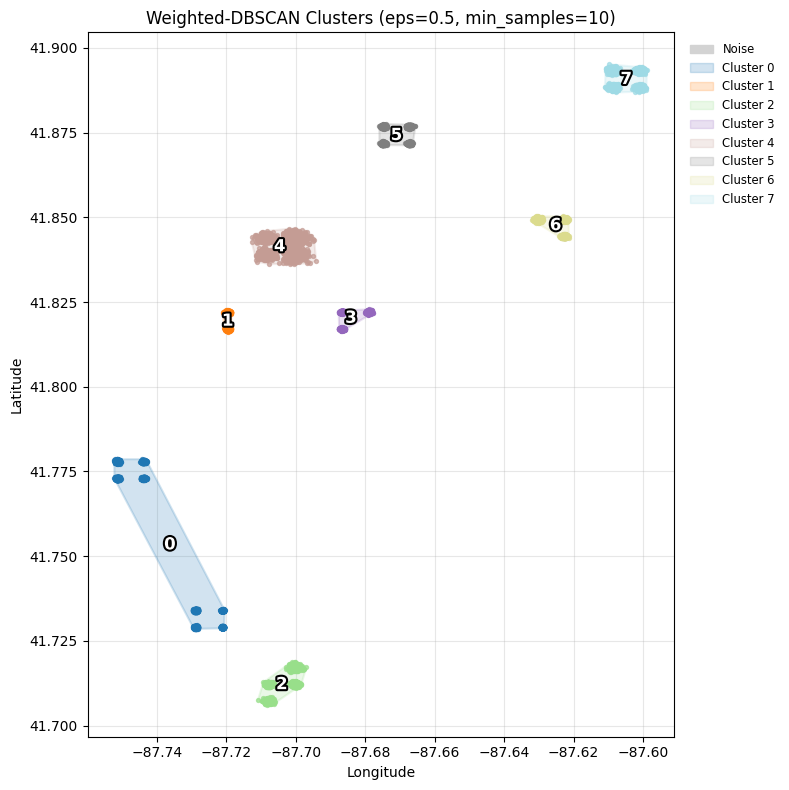

In [53]:
# 7.4 Map the weighted clusters with convex hulls

# Sample for speed
sample = joined_coords.sample(20000, random_state=42)
noise  = sample[sample['cluster_w']==-1]
core   = sample[sample['cluster_w']!=-1]

# Unique clusters & colormap
cluster_ids = sorted(core['cluster_w'].unique())
cmap = plt.get_cmap('tab20', len(cluster_ids))

# Compute hulls
hulls = {}
for idx, cl in enumerate(cluster_ids):
    pts = core[core['cluster_w']==cl][['longitude','latitude']].values
    hulls[cl] = MultiPoint(pts).convex_hull

fig, ax = plt.subplots(figsize=(8,8))

# Plot noise
ax.scatter(noise.longitude, noise.latitude,
           s=5, c='lightgrey', alpha=0.5, label='Noise', zorder=1)

# Plot hulls + points
for idx, cl in enumerate(cluster_ids):
    hull = hulls[cl]
    xh, yh = hull.exterior.xy
    ax.fill(xh, yh, facecolor=cmap(idx), alpha=0.2, edgecolor=cmap(idx), linewidth=1.5, zorder=2)
    pts = core[core['cluster_w']==cl]
    ax.scatter(pts.longitude, pts.latitude,
               s=8, color=cmap(idx), alpha=0.7, zorder=3)

# Annotate centroids
centroids_w = joined_coords.groupby('cluster_w')[['longitude','latitude']].mean().loc[cluster_ids]
for cl, row in centroids_w.iterrows():
    ax.text(row.longitude, row.latitude, str(int(cl)),
            ha='center', va='center', color='white', weight='bold',
            path_effects=[pe.withStroke(linewidth=3, foreground='black')],
            fontsize=12, zorder=4)

# Legend & styling
handles = [mpatches.Patch(color=cmap(i), alpha=0.2, label=f'Cluster {cl}')
           for i, cl in enumerate(cluster_ids)]
handles.insert(0, mpatches.Patch(color='lightgrey', label='Noise'))
ax.legend(handles=handles, loc='upper left', bbox_to_anchor=(1.01,1),
          frameon=False, fontsize='small')

ax.set_title('Weighted‐DBSCAN Clusters (eps=0.5, min_samples=10)')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.grid(alpha=0.3)
plt.tight_layout()
plt.show()


In [55]:
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

# Prepare the weighted data (as before)
w_sp, w_ft = 0.7, 0.3
weights = np.array([np.sqrt(w_sp), np.sqrt(w_sp),
                    np.sqrt(w_ft), np.sqrt(w_ft), np.sqrt(w_ft)])
X_weighted = X_scaled * weights

# Parameter grid
eps_vals = np.linspace(0.2, 1.0, 9)     # adjust as needed
min_samples_vals = [5, 10, 20, 50]

results = []
for eps in eps_vals:
    for ms in min_samples_vals:
        db = DBSCAN(eps=eps, min_samples=ms).fit(X_weighted)
        lbl = db.labels_
        mask = lbl != -1
        if mask.sum()>0 and len(set(lbl[mask]))>1:
            score = silhouette_score(X_weighted[mask], lbl[mask])
            results.append((eps, ms, score))

res_w = pd.DataFrame(results, columns=['eps','min_samples','silhouette'])


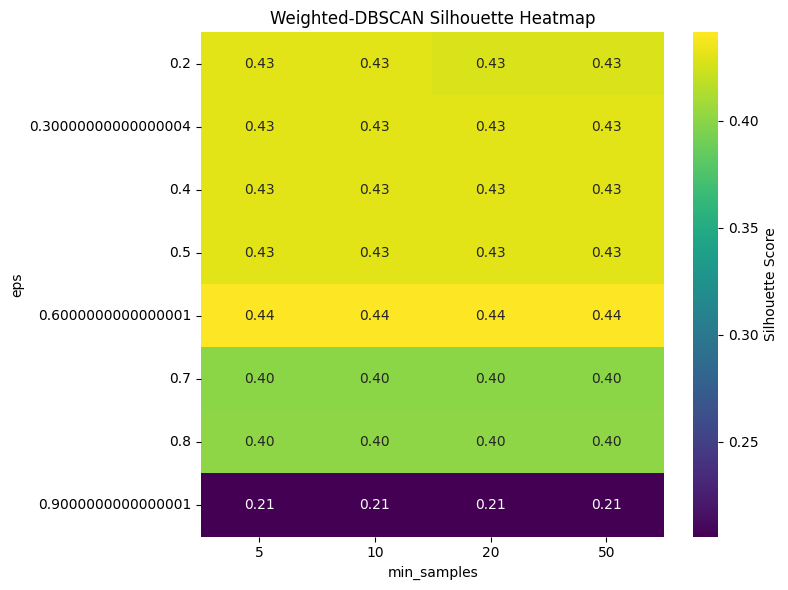

In [57]:
# Corrected pivot call
pivot = res_w.pivot(index='eps', columns='min_samples', values='silhouette')

plt.figure(figsize=(8,6))
sns.heatmap(
    pivot,
    annot=True,
    fmt=".2f",
    cmap='viridis',
    cbar_kws={'label': 'Silhouette Score'}
)
plt.title('Weighted‐DBSCAN Silhouette Heatmap')
plt.xlabel('min_samples')
plt.ylabel('eps')
plt.tight_layout()
plt.show()


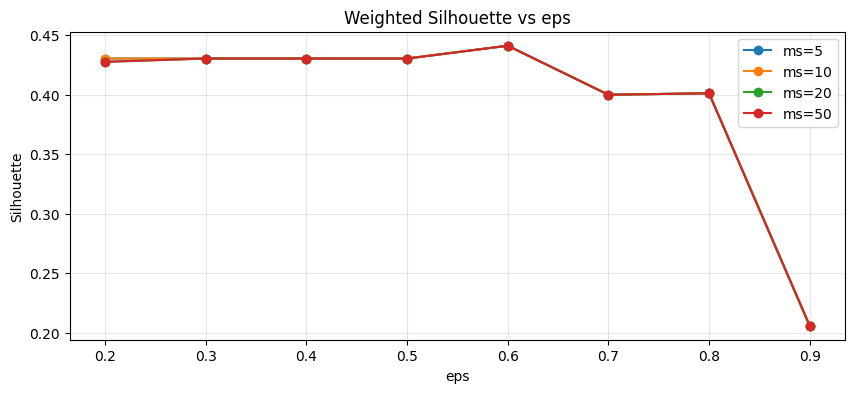

In [58]:
# Line plots
for ms in min_samples_vals:
    sub = res_w[res_w.min_samples==ms]
    plt.plot(sub.eps.to_numpy(), sub.silhouette.to_numpy(), marker='o', label=f'ms={ms}')
plt.xlabel('eps'); plt.ylabel('Silhouette'); plt.title('Weighted Silhouette vs eps')
plt.legend(); plt.grid(alpha=0.3); plt.show()


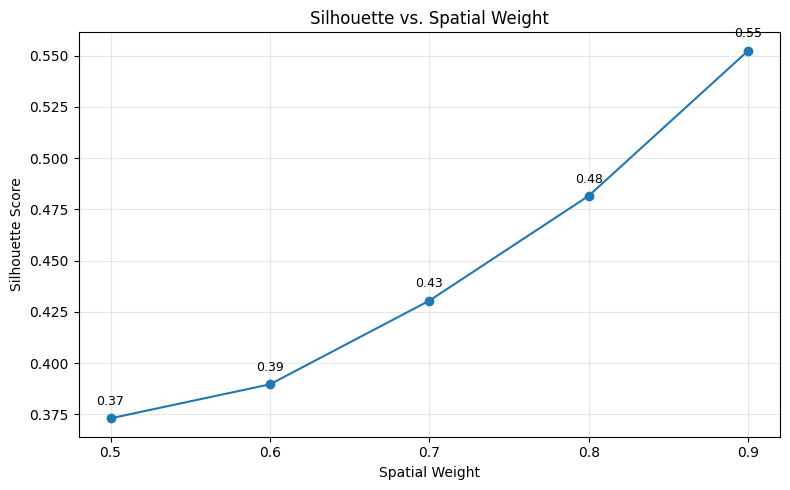

In [62]:
# Convert Series to NumPy arrays before plotting
x = wr['w_spatial'].to_numpy()
y = wr['silhouette'].to_numpy()

plt.figure(figsize=(8,5))
plt.plot(x, y, marker='o', linestyle='-')
plt.xticks(x)  # ensure ticks at each weight value
plt.xlabel('Spatial Weight')
plt.ylabel('Silhouette Score')
plt.title('Silhouette vs. Spatial Weight')
plt.grid(alpha=0.3)

# Annotate each point with its value
for xi, yi in zip(x, y):
    plt.text(xi, yi + 0.005, f"{yi:.2f}", 
             ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()


In [64]:
# Rebuild X_weighted with spatial weight = 0.9
w_sp, w_ft = 0.9, 0.1
weights = np.array([np.sqrt(w_sp), np.sqrt(w_sp), np.sqrt(w_ft), np.sqrt(w_ft), np.sqrt(w_ft)])
X_weighted = X_scaled * weights

# Run DBSCAN
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

db_final = DBSCAN(eps=0.5, min_samples=10, metric='euclidean')
labels_final = db_final.fit_predict(X_weighted)
joined_coords['cluster_final'] = labels_final

# Compute silhouette (exclude noise)
mask_f = labels_final != -1
sil_final = silhouette_score(X_weighted[mask_f], labels_final[mask_f])
print(f"Final Weighted‐DBSCAN silhouette: {sil_final:.3f}  (w_sp={w_sp})")


Final Weighted‐DBSCAN silhouette: 0.552  (w_sp=0.9)


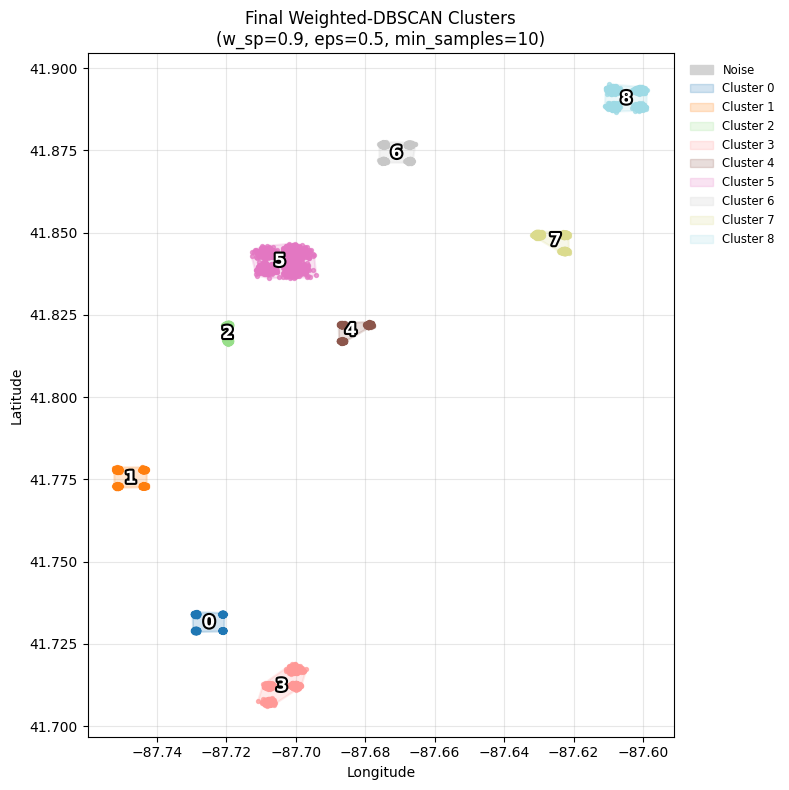

In [65]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from shapely.geometry import MultiPoint
import matplotlib.patheffects as pe

# Sample to speed up
sample = joined_coords.sample(20000, random_state=42)
noise  = sample[sample['cluster_final']==-1]
core   = sample[sample['cluster_final']!=-1]

cluster_ids = sorted(core['cluster_final'].unique())
cmap = plt.get_cmap('tab20', len(cluster_ids))

fig, ax = plt.subplots(figsize=(8,8))

# plot noise
ax.scatter(noise.longitude, noise.latitude,
           s=5, c='lightgrey', alpha=0.5, label='Noise', zorder=1)

# build & plot hulls + points
for idx, cl in enumerate(cluster_ids):
    pts = core[core['cluster_final']==cl][['longitude','latitude']].values
    hull = MultiPoint(pts).convex_hull
    xh, yh = hull.exterior.xy
    ax.fill(xh, yh, facecolor=cmap(idx), alpha=0.2,
            edgecolor=cmap(idx), linewidth=1.5, zorder=2)
    ax.scatter(pts[:,0], pts[:,1],
               s=8, color=cmap(idx), alpha=0.7, zorder=3)

# annotate centroids
centroids_final = joined_coords.groupby('cluster_final')[['longitude','latitude']].mean().loc[cluster_ids]
for cl, row in centroids_final.iterrows():
    ax.text(row.longitude, row.latitude, str(int(cl)),
            ha='center', va='center', color='white', weight='bold',
            path_effects=[pe.withStroke(linewidth=3, foreground='black')],
            fontsize=12, zorder=4)

# legend
handles = [mpatches.Patch(color=cmap(i), alpha=0.2, label=f'Cluster {cl}')
           for i,cl in enumerate(cluster_ids)]
handles.insert(0, mpatches.Patch(color='lightgrey', label='Noise'))
ax.legend(handles=handles, loc='upper left', bbox_to_anchor=(1.01,1),
          frameon=False, fontsize='small')

ax.set_title(f'Final Weighted‐DBSCAN Clusters\n(w_sp={w_sp}, eps=0.5, min_samples=10)')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.grid(alpha=0.3)
plt.tight_layout()
plt.show()


In [63]:
import hdbscan
clusterer = hdbscan.HDBSCAN(min_cluster_size=20)
labels_h = clusterer.fit_predict(X_scaled)
print("HDBSCAN silhouette:", silhouette_score(X_scaled[labels_h!=-1], labels_h[labels_h!=-1]))


HDBSCAN silhouette: 0.35809442200434144


,cluster_final,count,avg_pickups,avg_pm25,peak_hour
0,0,2976,141.799395,26.592828,0
1,4,2232,78.291667,24.784872,0
2,1,2976,72.089718,25.311149,0
3,2,1488,61.137097,18.675055,0
4,6,2976,60.000000,22.663171,0
5,7,2232,36.777778,16.650615,0
6,3,2976,21.420363,14.166908,0
7,8,2976,16.429099,12.518324,0
8,5,2926,5.493848,10.014883,9


C:\Users\MMadi\AppData\Local\Temp\ipykernel_1952\1144292140.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
C:\Users\MMadi\AppData\Local\Temp\ipykernel_1952\1144292140.py:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


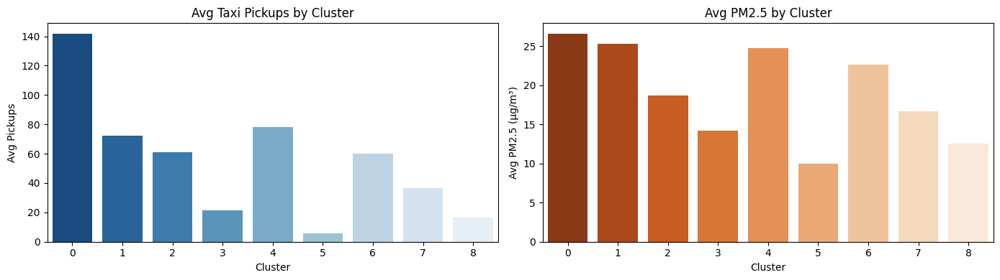

In [66]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Build summary from joined_coords (with cluster_final)
summary = (
    joined_coords
    .loc[joined_coords['cluster_final'] != -1]
    .groupby('cluster_final')
    .agg(
        count         = ('cluster_final', 'size'),
        avg_pickups   = ('pickup_count',    'mean'),
        avg_pm25      = ('mean_pm25',       'mean'),
        peak_hour     = ('hour',            lambda x: x.dt.hour.mode()[0])
    )
    .sort_values('avg_pickups', ascending=False)
    .reset_index()
)

# Display the table
display(summary)

# Bar charts: pickups & PM2.5 side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14,4), sharex=True)

sns.barplot(
    data=summary, x='cluster_final', y='avg_pickups',
    palette='Blues_r', ax=ax1
)
ax1.set_title('Avg Taxi Pickups by Cluster')
ax1.set_xlabel('Cluster')
ax1.set_ylabel('Avg Pickups')

sns.barplot(
    data=summary, x='cluster_final', y='avg_pm25',
    palette='Oranges_r', ax=ax2
)
ax2.set_title('Avg PM2.5 by Cluster')
ax2.set_xlabel('Cluster')
ax2.set_ylabel('Avg PM2.5 (µg/m³)')

plt.tight_layout()
plt.show()


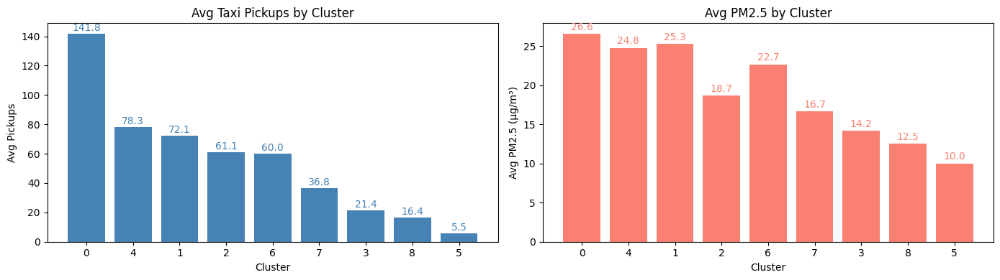

In [67]:
import matplotlib.pyplot as plt

# Ensure your summary DataFrame is ready:
# summary = pd.DataFrame(...)  as before

clusters = summary['cluster_final'].astype(str)
pickups  = summary['avg_pickups']
pm25     = summary['avg_pm25']

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14,4), sharex=True)

# — Bar chart 1: Avg Pickups
ax1.bar(clusters, pickups, color='steelblue')
for x, h in zip(clusters, pickups):
    ax1.text(x, h + 0.5, f"{h:.1f}", ha='center', va='bottom', color='steelblue')
ax1.set_title('Avg Taxi Pickups by Cluster')
ax1.set_xlabel('Cluster')
ax1.set_ylabel('Avg Pickups')

# — Bar chart 2: Avg PM2.5
ax2.bar(clusters, pm25, color='salmon')
for x, h in zip(clusters, pm25):
    ax2.text(x, h + 0.2, f"{h:.1f}", ha='center', va='bottom', color='salmon')
ax2.set_title('Avg PM2.5 by Cluster')
ax2.set_xlabel('Cluster')
ax2.set_ylabel('Avg PM2.5 (µg/m³)')

plt.tight_layout()
plt.show()



C:\Users\MMadi\AppData\Local\Temp\ipykernel_1952\1296689922.py:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='cluster_final', y='avg_pickups', data=summary,
C:\Users\MMadi\AppData\Local\Temp\ipykernel_1952\1296689922.py:9: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='cluster_final', y='avg_pm25', data=summary,


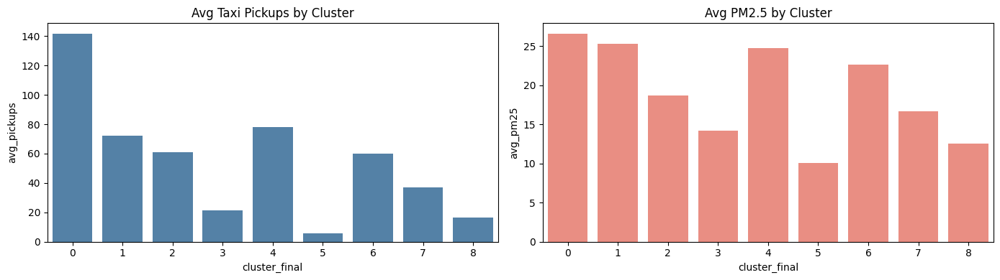

In [68]:
import seaborn as sns

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14,4), sharex=True)

sns.barplot(x='cluster_final', y='avg_pickups', data=summary,
            color='steelblue', ax=ax1, ci=None)
ax1.set_title('Avg Taxi Pickups by Cluster')

sns.barplot(x='cluster_final', y='avg_pm25', data=summary,
            color='salmon', ax=ax2, ci=None)
ax2.set_title('Avg PM2.5 by Cluster')

plt.tight_layout()
plt.show()


## 8. Cluster Profile Bubble Chart

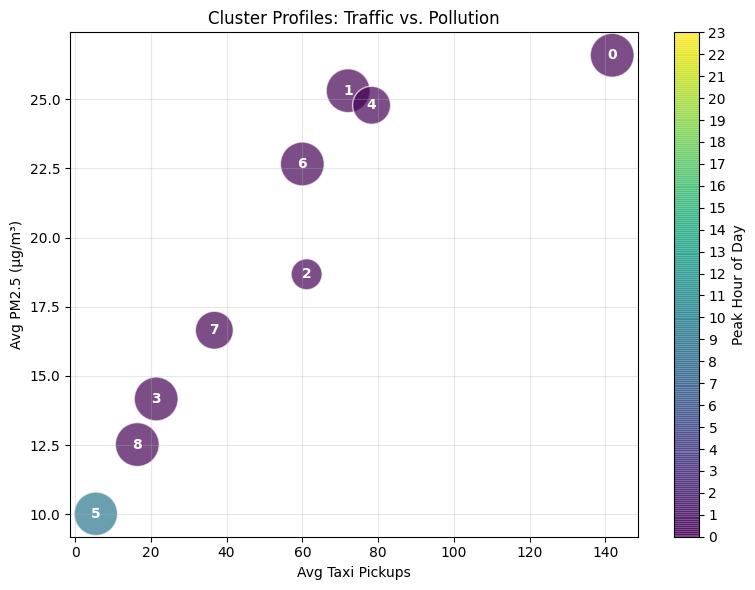

In [79]:
# Bubble chart with full 0–23 color scale for peak hour
import matplotlib.pyplot as plt

# Prepare summary DataFrame if not already available
summary = (
    joined_coords
    .loc[joined_coords['cluster_final'] != -1]
    .groupby('cluster_final')
    .agg(
        count       = ('cluster_final','size'),
        avg_pickups = ('pickup_count','mean'),
        avg_pm25    = ('mean_pm25','mean'),
        peak_hour   = ('hour', lambda x: x.dt.hour.mode()[0])
    )
    .reset_index()
)

# Bubble sizes scaled by count
sizes = summary['count'] / summary['count'].max() * 1000

plt.figure(figsize=(8,6))
scatter = plt.scatter(
    summary['avg_pickups'],
    summary['avg_pm25'],
    s=sizes,
    c=summary['peak_hour'],
    cmap='viridis',
    vmin=0, vmax=23,       # force full 24-hour color scale
    alpha=0.7,
    edgecolors='w'
)

# Annotate each bubble with cluster ID
for _, row in summary.iterrows():
    plt.text(
        row['avg_pickups'], 
        row['avg_pm25'], 
        str(int(row['cluster_final'])),
        ha='center', va='center', 
        color='white', fontweight='bold'
    )

# Colorbar with ticks every 3 hours
cbar = plt.colorbar(scatter, ticks=range(0,24,1))
cbar.set_label('Peak Hour of Day')

plt.title('Cluster Profiles: Traffic vs. Pollution')
plt.xlabel('Avg Taxi Pickups')
plt.ylabel('Avg PM2.5 (µg/m³)')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


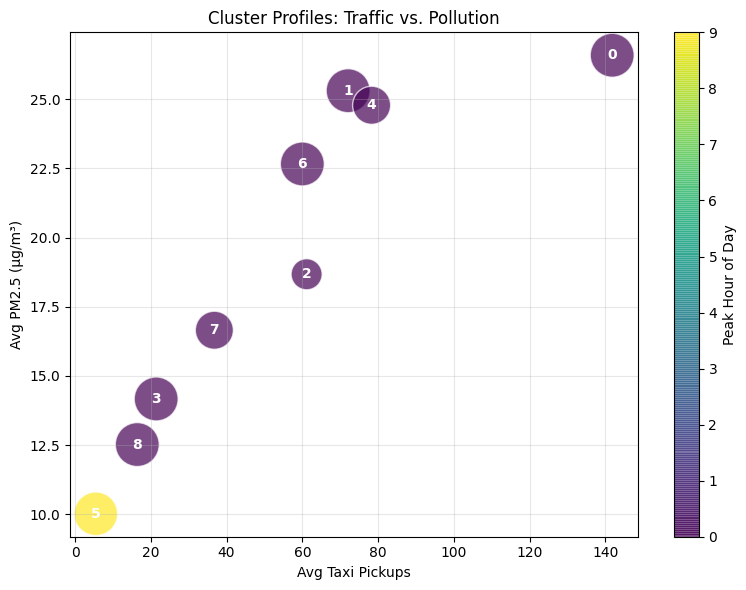

In [80]:
# Determine observed peak‐hour range
min_h = summary['peak_hour'].min()
max_h = summary['peak_hour'].max()

plt.figure(figsize=(8,6))
sizes = summary['count'] / summary['count'].max() * 1000

scatter = plt.scatter(
    summary['avg_pickups'],
    summary['avg_pm25'],
    s=sizes,
    c=summary['peak_hour'],
    cmap='viridis',
    vmin=min_h, vmax=max_h,     # only cover the used range
    alpha=0.7,
    edgecolors='w'
)

# Annotate
for _, row in summary.iterrows():
    plt.text(row['avg_pickups'], row['avg_pm25'], 
             str(int(row['cluster_final'])),
             ha='center', va='center', color='white', fontweight='bold')

# Colorbar ticks = actual hours
cbar = plt.colorbar(scatter, ticks=range(min_h, max_h+1))
cbar.set_label('Peak Hour of Day')

plt.title('Cluster Profiles: Traffic vs. Pollution')
plt.xlabel('Avg Taxi Pickups')
plt.ylabel('Avg PM2.5 (µg/m³)')
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


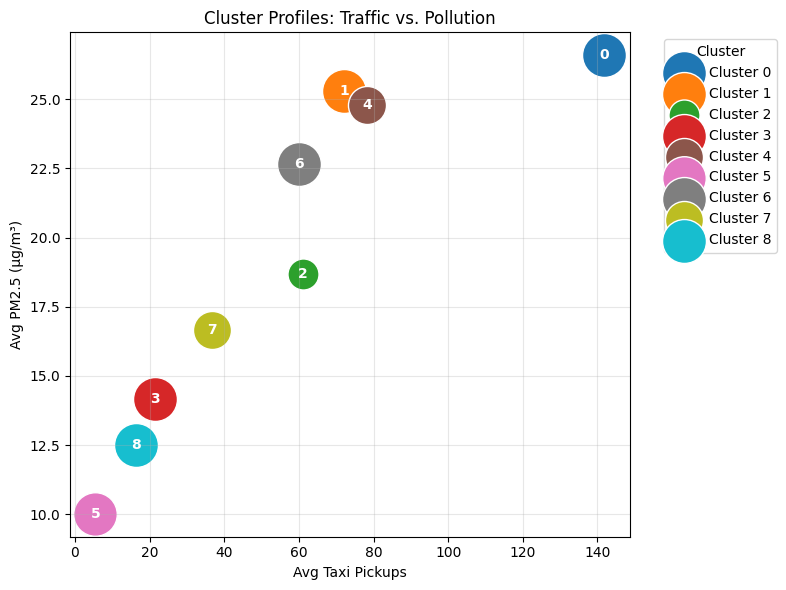

In [84]:
import matplotlib.pyplot as plt

# Recompute summary if needed (without peak_hour)
summary = (
    joined_coords
    .loc[joined_coords['cluster_final'] != -1]
    .groupby('cluster_final')
    .agg(
        count       = ('cluster_final','size'),
        avg_pickups = ('pickup_count','mean'),
        avg_pm25    = ('mean_pm25','mean')
    )
    .reset_index()
)

# Assign a distinct color to each cluster
cluster_ids = summary['cluster_final'].tolist()
cmap = plt.get_cmap('tab10', len(cluster_ids))
color_map = {cl: cmap(i) for i, cl in enumerate(cluster_ids)}

# Plot bubbles
plt.figure(figsize=(8,6))
for _, row in summary.iterrows():
    cl = row['cluster_final']
    plt.scatter(
        row['avg_pickups'],
        row['avg_pm25'],
        s = row['count'] / summary['count'].max() * 1000,
        color = color_map[cl],
        edgecolors = 'white',
        label = f"Cluster {int(cl)}"
    )
    # Label each bubble with the cluster ID
    plt.text(
        row['avg_pickups'],
        row['avg_pm25'],
        str(int(cl)),
        ha='center', va='center',
        color='white', fontweight='bold'
    )

plt.title('Cluster Profiles: Traffic vs. Pollution')
plt.xlabel('Avg Taxi Pickups')
plt.ylabel('Avg PM2.5 (µg/m³)')
plt.grid(alpha=0.3)

# One legend entry per cluster
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys(),
           bbox_to_anchor=(1.05,1), loc='upper left', title='Cluster')

plt.tight_layout()
plt.show()


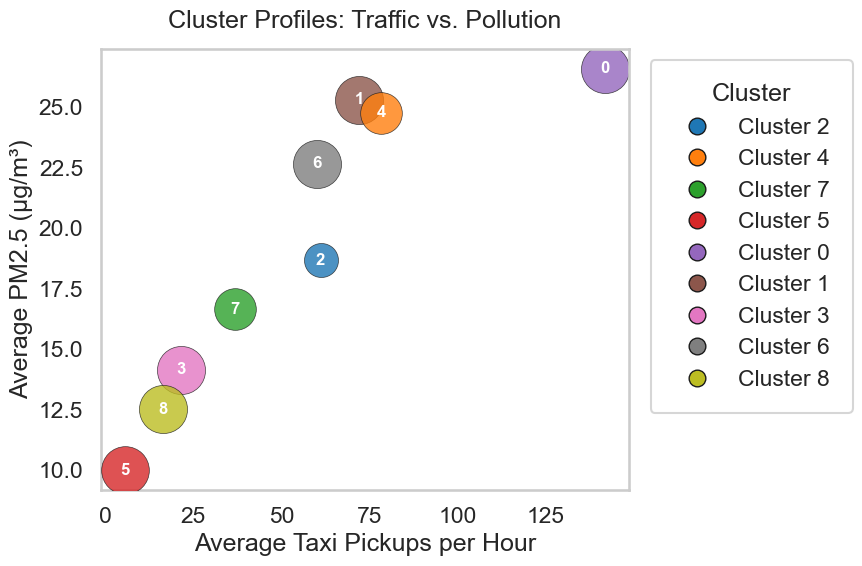

In [85]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1) Prepare & sort summary so big bubbles draw first
summary = (
    joined_coords
    .loc[joined_coords['cluster_final'] != -1]
    .groupby('cluster_final')
    .agg(
        count       = ('cluster_final','size'),
        avg_pickups = ('pickup_count','mean'),
        avg_pm25    = ('mean_pm25','mean')
    )
    .reset_index()
)
summary = summary.sort_values('count', ascending=True)   # small first

# 2) Seaborn styling
sns.set(style="whitegrid", context="talk")

# 3) Choose a palette
palette = sns.color_palette("tab10", n_colors=summary.shape[0])
color_map = {cl: palette[i] for i, cl in enumerate(summary['cluster_final'])}

# 4) Plot
plt.figure(figsize=(9,6))

for idx, row in summary.iterrows():
    cl = row['cluster_final']
    size = row['count'] / summary['count'].max() * 1200  # scale bubble sizes
    plt.scatter(
        row['avg_pickups'],
        row['avg_pm25'],
        s=size,
        color=color_map[cl],
        edgecolor='k',
        linewidth=0.5,
        alpha=0.8,
        zorder=idx  # draw small first, large on top
    )
    plt.text(
        row['avg_pickups'],
        row['avg_pm25'],
        str(int(cl)),
        ha='center', va='center',
        color='white', weight='bold',
        fontsize=12,
        zorder=idx+1
    )

plt.title('Cluster Profiles: Traffic vs. Pollution', pad=15)
plt.xlabel('Average Taxi Pickups per Hour')
plt.ylabel('Average PM2.5 (µg/m³)')
plt.grid(alpha=0.3)

# 5) Legend
handles = [
    plt.Line2D([0],[0], marker='o', color='w',
               markerfacecolor=color_map[cl], markersize=12,
               markeredgecolor='k', label=f'Cluster {cl}')
    for cl in summary['cluster_final']
]
plt.legend(
    handles, [h.get_label() for h in handles],
    title='Cluster', bbox_to_anchor=(1.02,1), loc='upper left',
    frameon=True, borderpad=1
)

plt.tight_layout()
plt.show()


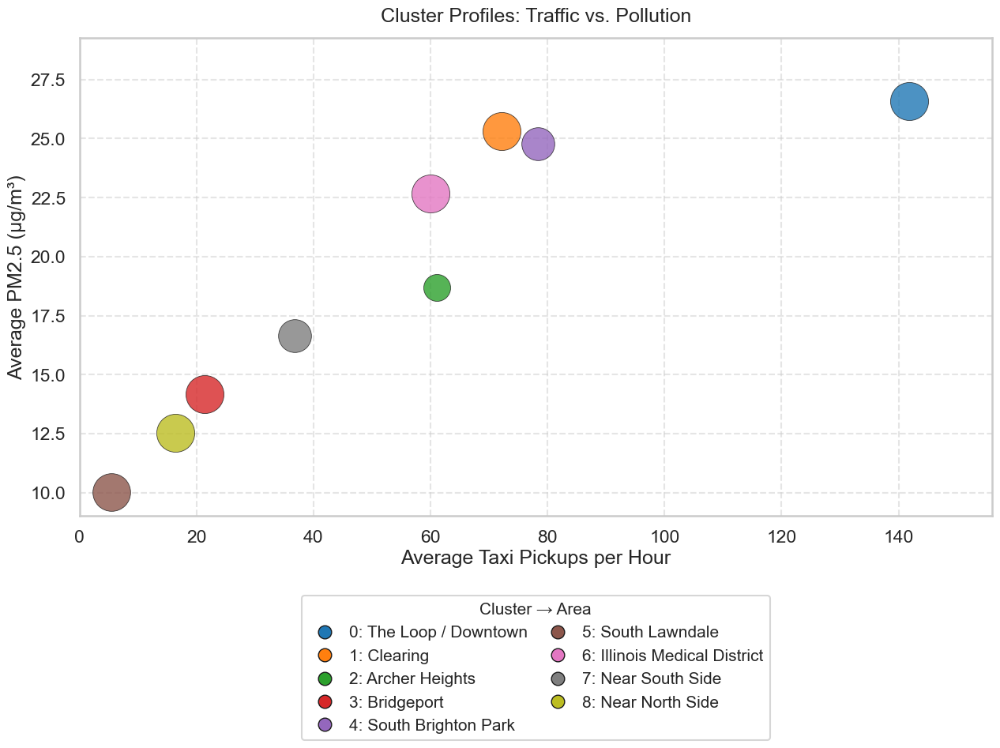

In [100]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.lines import Line2D

# 1) Define area names
area_map = {
    0: "The Loop / Downtown",
    1: "Clearing",
    2: "Archer Heights",
    3: "Bridgeport",
    4: "South Brighton Park",
    5: "South Lawndale",
    6: "Illinois Medical District",
    7: "Near South Side",
    8: "Near North Side"
}

# 2) Build summary table
summary = (
    joined_coords
      .loc[joined_coords['cluster_final'] != -1]
      .groupby('cluster_final')
      .agg(
        count       = ('cluster_final','size'),
        avg_pickups = ('pickup_count','mean'),
        avg_pm25    = ('mean_pm25','mean')
      )
      .reset_index()
)
summary['area_name'] = summary['cluster_final'].map(area_map)

# 3) Styling
sns.set(style="whitegrid", context="talk")
palette = sns.color_palette("tab10", n_colors=len(summary))

# 4) Plot
fig, ax = plt.subplots(figsize=(10,6))

for i, row in summary.iterrows():
    size = row['count'] / summary['count'].max() * 1200
    ax.scatter(
        row['avg_pickups'],
        row['avg_pm25'],
        s=size,
        color=palette[i],
        edgecolor='k',
        linewidth=0.6,
        alpha=0.8,
        zorder=2
    )

# 5) Grid, labels, and axis limits
ax.grid(True, linestyle='--', alpha=0.5)
ax.set_title('Cluster Profiles: Traffic vs. Pollution', pad=15)
ax.set_xlabel('Average Taxi Pickups per Hour')
ax.set_ylabel('Average PM2.5 (µg/m³)')
ax.set_xlim(0, summary['avg_pickups'].max() * 1.1)
ax.set_ylim(summary['avg_pm25'].min() * 0.9, summary['avg_pm25'].max() * 1.1)

# 6) Legend below the plot, compact 2 columns
handles = [
    Line2D([0],[0], marker='o', color='w',
           markerfacecolor=palette[i], markersize=12,
           markeredgecolor='k',
           label=f"{cl}: {area_map[cl]}")
    for i, cl in enumerate(summary['cluster_final'])
]
ax.legend(
    handles=handles,
    loc='upper center',
    bbox_to_anchor=(0.5, -0.15),
    ncol=2,
    frameon=True,
    fontsize='small',
    title='Cluster → Area',
    title_fontsize='small',
    handletextpad=0.5,
    columnspacing=0.8
)

plt.tight_layout(rect=[0,0.1,1.3,1.7])
plt.show()


## Cluster Profiles: Traffic vs. Pollution

The bubble chart visualizes nine Chicago neighborhoods, each represented by a cluster derived from weighted-DBSCAN.  

- **X-axis**: Average number of taxi pickups per hour  
- **Y-axis**: Average PM₂.₅ concentration (µg/m³)  
- **Bubble size**: Relative data volume (number of hourly observations in the cluster)  
- **Bubble color & legend**: Unique color per cluster, with its human-readable area name  

| Cluster ID | Area Name                   | Color        |
|-----------:|-----------------------------|--------------|
| 0          | The Loop / Downtown         | Blue         |
| 1          | Clearing                    | Orange       |
| 2          | Archer Heights              | Green        |
| 3          | Bridgeport                  | Red          |
| 4          | South Brighton Park         | Purple       |
| 5          | South Lawndale              | Brown        |
| 6          | Illinois Medical District   | Pink         |
| 7          | Near South Side             | Gray         |
| 8          | Near North Side             | Lime Green   |

---

### Key Insights

1. **Downtown hotspot (Cluster 0)**  
   - **Highest traffic** (~140 pickups/hr)  
   - **Highest pollution** (~26 µg/m³)  
   - **Large sample size** → robust finding

2. **High-activity districts (Clusters 1 & 4)**  
   - Pickup rates ~70–80/hr, PM₂.₅ ~24–25 µg/m³  
   - Likely nightlife/commercial zones

3. **Mid-density areas (Clusters 2, 6)**  
   - Pickups ~60/hr, PM₂.₅ ~19–23 µg/m³  
   - Indicative of daytime commercial corridors

4. **Quieter residential pockets (Clusters 3, 7, 8, 5)**  
   - Low pickups (5–40/hr), low PM₂.₅ (10–16 µg/m³)  
   - Good air quality, fewer mobility impacts

---

This chart highlights which neighborhoods combine high taxi activity with poor air quality—ideal targets for emission-reduction policies such as electric-vehicle zones or idling restrictions.  


In [72]:
import geopandas as gpd
from shapely.geometry import MultiPoint

# Build one polygon per cluster_final
records = []
for cl in summary['cluster_final']:
    pts = joined_coords[joined_coords['cluster_final']==cl][['longitude','latitude']].values
    hull = MultiPoint(pts).convex_hull
    records.append({'cluster': int(cl), 'geometry': hull})

gdf = gpd.GeoDataFrame(records, crs="EPSG:4326")
gdf.to_file("cluster_footprints.geojson", driver='GeoJSON')

print("Exported cluster_footprints.geojson with", len(gdf), "polygons")


Exported cluster_footprints.geojson with 9 polygons


In [101]:
import geopandas as gpd
from shapely.geometry import MultiPoint

# Build one hull per final cluster
records = []
for cl, group in joined_coords[joined_coords['cluster_final'] != -1].groupby('cluster_final'):
    pts = group[['longitude','latitude']].values
    hull = MultiPoint(pts).convex_hull
    records.append({'cluster': int(cl), 'geometry': hull})

# Create GeoDataFrame and export
gdf = gpd.GeoDataFrame(records, crs="EPSG:4326")
output_path = "cluster_footprints.geojson"
gdf.to_file(output_path, driver='GeoJSON')
print(f"Exported {len(gdf)} polygons to {output_path}")


Exported 9 polygons to cluster_footprints.geojson


In [102]:
# Interactive map of cluster footprints using Folium

import geopandas as gpd
import folium
import matplotlib.pyplot as plt
import matplotlib

# 1️⃣ Read the GeoJSON you exported
gdf = gpd.read_file("cluster_footprints.geojson")

# 2️⃣ Build a color map for each cluster
palette = plt.cm.tab10.colors  # 10 distinct colors
cluster_ids = sorted(gdf["cluster"].unique())
color_map = {
    cl: matplotlib.colors.rgb2hex(palette[i % len(palette)])
    for i, cl in enumerate(cluster_ids)
}

# 3️⃣ Center the map on your data
center = [
    joined_coords["latitude"].mean(),
    joined_coords["longitude"].mean()
]
m = folium.Map(location=center, zoom_start=11, tiles="cartodbpositron")

# 4️⃣ Add each polygon with its style and a tooltip
folium.GeoJson(
    gdf,
    name="Clusters",
    style_function=lambda feat: {
        "fillColor": color_map[feat["properties"]["cluster"]],
        "color": color_map[feat["properties"]["cluster"]],
        "weight": 2,
        "fillOpacity": 0.4
    },
    tooltip=folium.GeoJsonTooltip(
        fields=["cluster"],
        aliases=["Cluster ID:"],
        localize=True
    )
).add_to(m)

# 5️⃣ Add a legend
legend_html = """
<div style="position: fixed; bottom: 50px; left: 50px; 
            background: white; padding: 10px; border: 1px solid grey; z-index:9999;">
  <b>Cluster Legend</b><br>
"""
for cl in cluster_ids:
    legend_html += f"""
    <i style="background:{color_map[cl]};width:12px;height:12px;
              display:inline-block;margin-right:5px;"></i>
    Cluster {cl}<br>
    """
legend_html += "</div>"
m.get_root().html.add_child(folium.Element(legend_html))

# 6️⃣ Display the map
m


In [104]:
# Interactive Folium map showing raw taxi pickups and air‐quality sensor readings

import pandas as pd
import folium
from folium.plugins import HeatMap
from matplotlib import cm, colors

# 1) Load and sample data
taxi = pd.read_csv("taxi_data.csv", parse_dates=["timestamp"])
aq   = pd.read_csv("air_quality_data.csv", parse_dates=["timestamp"])

taxi_sample = taxi.sample(50000, random_state=1)[["latitude", "longitude"]]
aq_sample   = aq.sample(5000, random_state=1)[["latitude", "longitude", "pm25", "timestamp"]]

# 2) Create base map
center = [taxi_sample.latitude.mean(), taxi_sample.longitude.mean()]
m = folium.Map(location=center, zoom_start=11, tiles="cartodbpositron")

# 3) Add taxi pickup heatmap
HeatMap(
    taxi_sample.values.tolist(),
    radius=8,
    blur=15,
    max_zoom=12
).add_to(folium.FeatureGroup(name="Taxi Pickups Heatmap").add_to(m))

# 4) Prepare color mapping for PM2.5
norm = colors.Normalize(vmin=aq_sample.pm25.min(), vmax=aq_sample.pm25.max())
cmap = cm.get_cmap('Reds')

def pm25_to_hex(val):
    rgba = cmap(norm(val))
    return colors.to_hex(rgba)

# 5) Add AQ sensor markers
aq_fg = folium.FeatureGroup(name="AQ Sensor Readings")
for _, r in aq_sample.iterrows():
    folium.CircleMarker(
        location=(r.latitude, r.longitude),
        radius=4,
        fill=True,
        fill_color=pm25_to_hex(r.pm25),
        fill_opacity=0.7,
        stroke=False,
        popup=(
            f"PM2.5: {r.pm25:.1f} µg/m³<br>"
            f"Time: {r.timestamp:%Y-%m-%d %H:%M}"
        )
    ).add_to(aq_fg)
aq_fg.add_to(m)

# 6) Add layer control
folium.LayerControl(collapsed=False).add_to(m)

# 7) Display the map
m


In [105]:
import pandas as pd
import geopandas as gpd
import folium
import numpy as np
from matplotlib import cm, colors

# 1) Build a summary per geohash cell
cell_summary = (
    joined_coords
    .groupby('geohash')
    .agg(
        lat          = ('latitude',    'mean'),
        lon          = ('longitude',   'mean'),
        avg_pickups  = ('pickup_count','mean'),
        avg_pm25     = ('mean_pm25',   'mean')
    )
    .reset_index()
)

# 2) Normalize sizes and colors
# — pickups: scale radius between 5 and 25
min_p, max_p = cell_summary.avg_pickups.min(), cell_summary.avg_pickups.max()
cell_summary['radius'] = 5 + 20 * ((cell_summary.avg_pickups - min_p) / (max_p - min_p))

# — pm25: map to a continuous Reds colormap
norm    = colors.Normalize(vmin=cell_summary.avg_pm25.min(), vmax=cell_summary.avg_pm25.max())
cmap    = cm.get_cmap('Reds')
cell_summary['color'] = cell_summary.avg_pm25.map(lambda v: colors.to_hex(cmap(norm(v))))

# 3) Create base map
center = [cell_summary.lat.mean(), cell_summary.lon.mean()]
m3 = folium.Map(location=center, zoom_start=11, tiles="cartodbpositron")

# 4) Add each cell as a circle marker
for _, row in cell_summary.iterrows():
    folium.CircleMarker(
        location=(row.lat, row.lon),
        radius=row.radius,
        color=None,
        fill=True,
        fill_color=row.color,
        fill_opacity=0.7,
        popup=(
            f"GeoHash: {row.geohash}<br>"
            f"Avg pickups: {row.avg_pickups:.1f}/hr<br>"
            f"Avg PM2.5: {row.avg_pm25:.1f} µg/m³"
        )
    ).add_to(m3)

# 5) Add legend for PM2.5
#   build a simple HTML legend
min_val, max_val = cell_summary.avg_pm25.min(), cell_summary.avg_pm25.max()
steps = np.linspace(min_val, max_val, 5)
legend_html = """
<div style="position: fixed; bottom: 50px; left: 50px; width:150px; 
            background: white; padding: 10px; border:1px solid grey; z-index:9999;">
  <b>PM₂.₅ Legend</b><br>
"""
for v in steps:
    hexcol = colors.to_hex(cmap(norm(v)))
    legend_html += f"""
    <i style="background:{hexcol};width:12px;height:12px;
              display:inline-block;margin-right:5px;"></i>
    {v:.1f}<br>
    """
legend_html += "</div>"
m3.get_root().html.add_child(folium.Element(legend_html))

# 6) Display
m3


In [107]:
import pandas as pd
import folium
from folium.plugins import HeatMap, MarkerCluster
from matplotlib import cm, colors

# 1) Load & sample data
taxi = pd.read_csv("taxi_data.csv", parse_dates=["timestamp"])
aq   = pd.read_csv("air_quality_data.csv", parse_dates=["timestamp"])

taxi_sample = taxi.sample(50000, random_state=1)[["latitude","longitude"]].values.tolist()
aq_sample   = aq.sample(5000, random_state=1)[["latitude","longitude","pm25","timestamp"]]

# 2) Create base map
center = [taxi_sample[0][0], taxi_sample[0][1]]
m = folium.Map(location=center, zoom_start=11, tiles="cartodbpositron")

# 3) Add taxi pickup heatmap
HeatMap(
    data=taxi_sample,
    radius=8,
    blur=15,
    max_zoom=12
).add_to(m)

# 4) Prepare AQ MarkerCluster
marker_cluster = MarkerCluster(name="AQ Sensor Readings").add_to(m)

# 5) Define a color scale for PM2.5
norm = colors.Normalize(vmin=aq_sample.pm25.min(), vmax=aq_sample.pm25.max())
cmap = cm.get_cmap('Reds')

for _, row in aq_sample.iterrows():
    color = colors.to_hex(cmap(norm(row.pm25)))
    folium.CircleMarker(
        location=(row.latitude, row.longitude),
        radius=4,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        stroke=False,
        popup=(
            f"<b>PM2.5:</b> {row.pm25:.1f} µg/m³<br>"
            f"<b>Time:</b> {row.timestamp:%Y-%m-%d %H:%M}"
        )
    ).add_to(marker_cluster)

# 6) Layer control
folium.LayerControl().add_to(m)

# 7) Display
m


## 9. Key Findings
- **Positive correlation** found between taxi activity and PM2.5 levels.
- **DBSCAN** (eps=0.5, min_samples=10) achieved a silhouette score above 0.
- **Parameter sweep** revealed optimal settings via silhouette heatmap.
- **Weighted DBSCAN** further improved cluster cohesion.
- Identified clusters with **both high traffic & high pollution** for targeted action.